# Artifact Rejection Attempt #2

In [2]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

import numpy as np
import scipy
import pandas as pd
import tdt
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

import hypnogram as hp
import kd_analysis.main.utils as kd
import kd_analysis.main.plots as kp
import neurodsp.plts.utils as dspu
import sleep_score_for_me.v1.ssfm_v1 as ss
import sleep_score_for_me.utils.ssfm_utils as ssu

import adtk
from adtk.detector import GeneralizedESDTestAD
from adtk.visualization import plot

bp_def = dict(delta=(0.5, 4), theta=(4, 8), sigma = (11, 16), beta = (13, 20), low_gamma = (40, 55), high_gamma = (65, 80), omega=(300, 700))

kd_ref = {}
kd_ref['echans'] = [1,2]
kd_ref['fchans']=[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16]
kd_ref['analysis_root'] = Path('/Volumes/paxilline/Data/paxilline_project_materials/PAX_7/PAX_7_analysis_data')
kd_ref['tank_root'] = Path('/Volumes/paxilline/Data/PAX_7/PAX_7_TANK')

In [ ]:
# Might want these things eventually...
ssfm['ebp_pd'] = kd.get_bp_set2(ssfm['espg'], bands=bp_def, pandas=True)
ssfm['ebp'] = kd.get_bp_set2(ssfm['espg'], bands=bp_def, pandas=False)

In [3]:
# Standard test dataset for SSFM:
data_path = '/Volumes/paxilline/Data/PAX_7/PAX_7_TANK/PAX_7-dmso-bl'
art = {}


In [4]:
art['e'], art['espg'] = kd.get_data_spg(data_path, store='EEGr', t1=0, t2=7200, channel=kd_ref['echans'], window_length=5, overlap=1)
art['e.pd'], art['espg.pd'] = kd.get_data_spg(data_path, store='EEGr', t1=0, t2=7200, channel=kd_ref['echans'], window_length=5, overlap=1, pandas=True)

art['m'], art['mspg'] = kd.get_data_spg(data_path, store='EMGr', t1=0, t2=7200, channel=[1,2], window_length=5, overlap=1)
art['m.pd'], art['mspg.pd'] = kd.get_data_spg(data_path, store='EMGr', t1=0, t2=7200, channel=[1,2], window_length=5, overlap=1, pandas=True)

art['f'], art['fspg'] = kd.get_data_spg(data_path, store='LFP_', t1=0, t2=7200, channel=kd_ref['fchans'], window_length=5, overlap=1)
art['f.pd'], art['fspg.pd'] = kd.get_data_spg(data_path, store='LFP_', t1=0, t2=7200, channel=kd_ref['fchans'], window_length=5, overlap=1, pandas=True)

read from t=0s to t=7502.02s
Using 1525.8789 Hz as SEV sampling rate for EEGr
Remember to save all data in xset-style dictionary, and to add experiment name key (key = "name") before using save_xset
read from t=0s to t=7502.02s
Using 1525.8789 Hz as SEV sampling rate for EEGr
Remember to save all data in xset-style dictionary, and to add experiment name key (key = "name") before using save_xset
read from t=0s to t=7502.02s
Remember to save all data in xset-style dictionary, and to add experiment name key (key = "name") before using save_xset
read from t=0s to t=7502.02s
Remember to save all data in xset-style dictionary, and to add experiment name key (key = "name") before using save_xset
read from t=0s to t=7502.02s
Using 3051.7578 Hz as SEV sampling rate for LFP_
Remember to save all data in xset-style dictionary, and to add experiment name key (key = "name") before using save_xset
read from t=0s to t=7502.02s
Using 3051.7578 Hz as SEV sampling rate for LFP_
Remember to save all data

In [5]:
hyp_yaml = "N:\Data\paxilline_project_materials\pax-hypno-paths.yaml"
subject = "PAX_7"
exp = "exp-2"
p_2h = "/Volumes/paxilline/Data//paxilline_project_materials/PAX_7/hypnograms-PAX_7/hypno_dmso_BL1.txt"

art['hyp_full'] = kd.load_hypnograms(subject, exp, "dmso-bl", art['espg'].datetime.values.min())
art['hyp_2hr'] = ssu.load_hypno(p_2h, art['espg'].datetime.values.min())



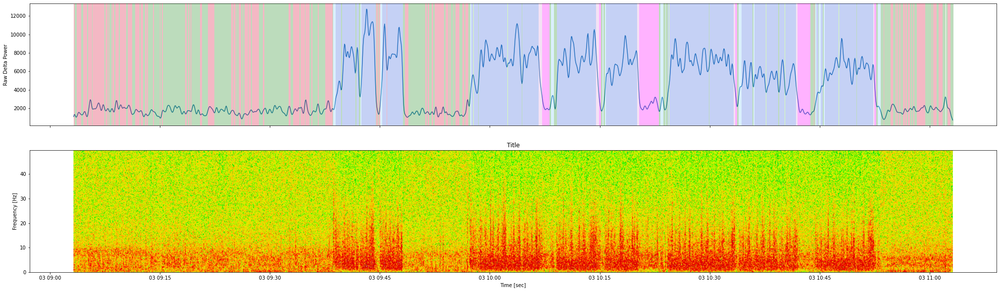

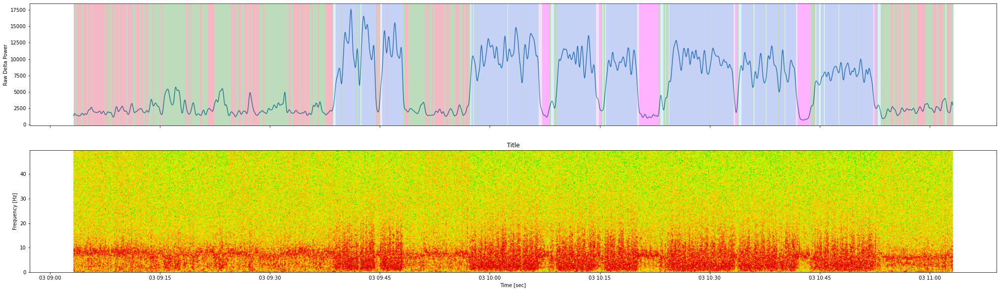

In [5]:
for chan in [1,2]:
    b, s = kp.plot_bp_and_spectro(art['espg'], chan=chan, hyp=art['hyp_2hr'], bp_def=bp_def, band='delta')

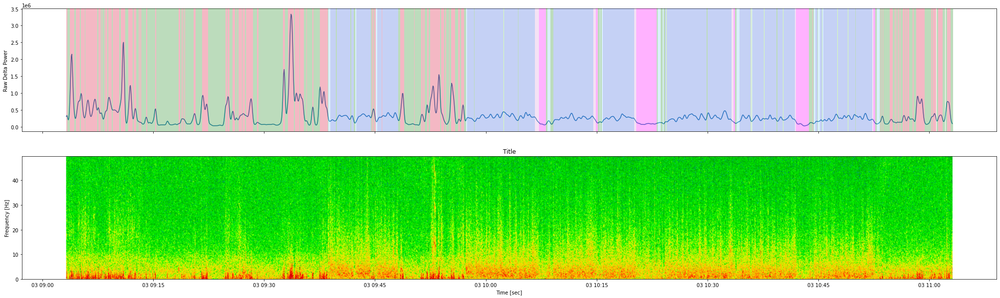

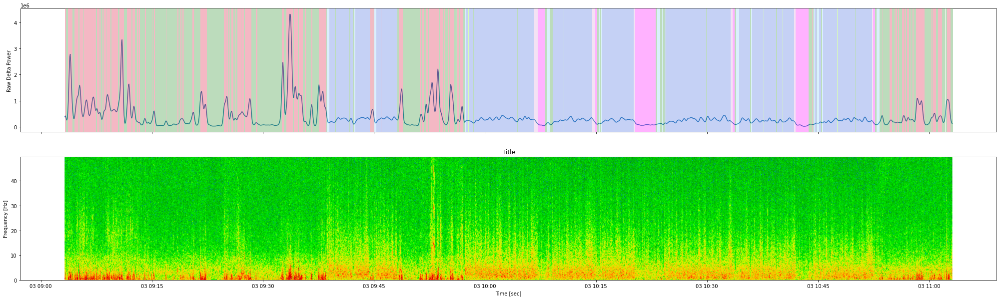

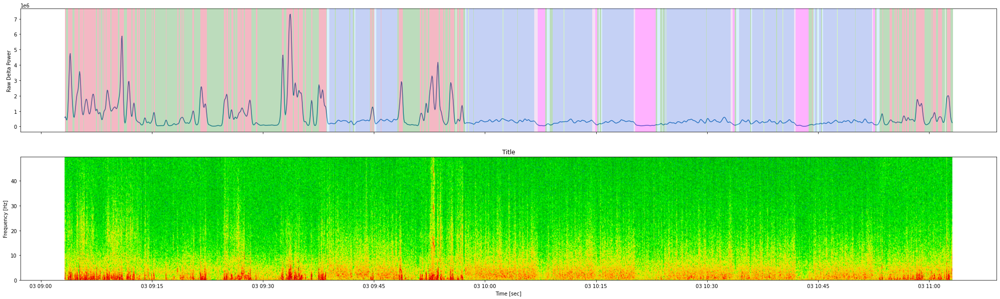

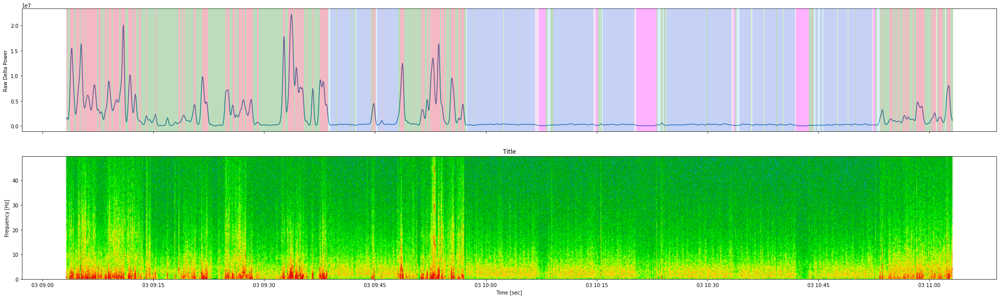

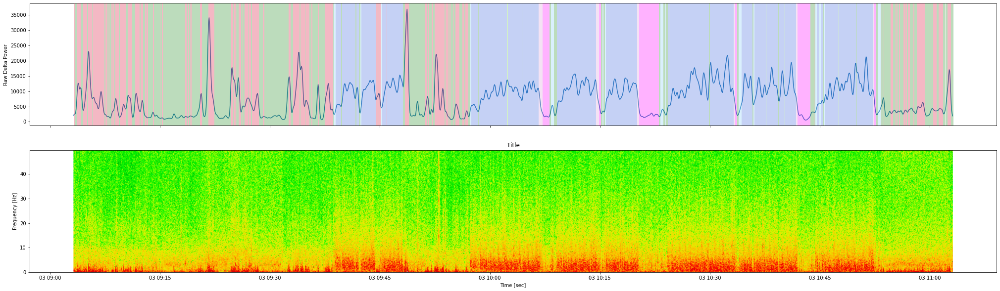

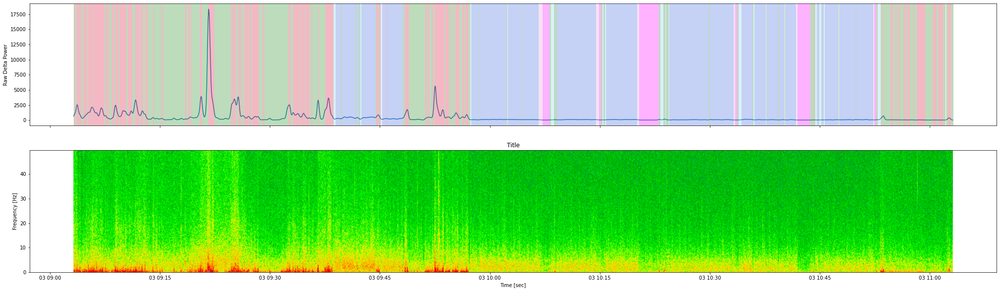

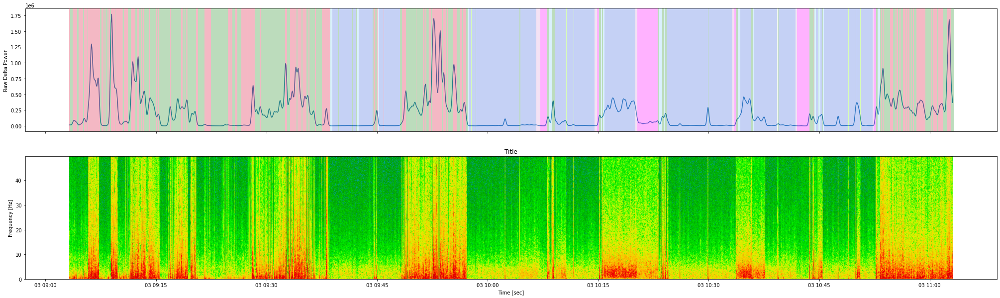

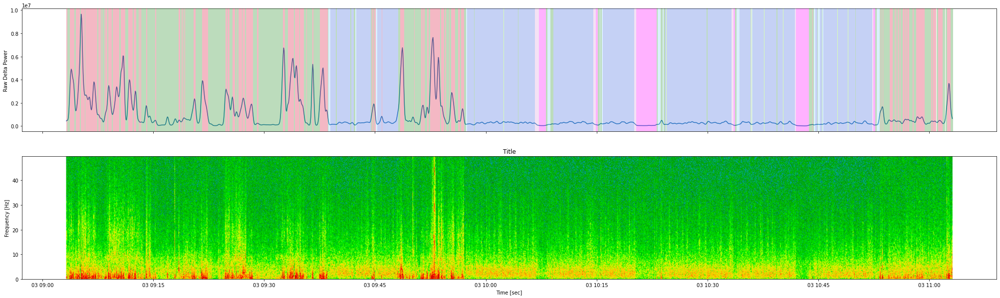

In [11]:
for chan in [1,3,5,7,9,11,13,15]:
    b, s = kp.plot_bp_and_spectro(art['fspg'], chan=chan, hyp=art['hyp_2hr'], bp_def=bp_def, band='delta')

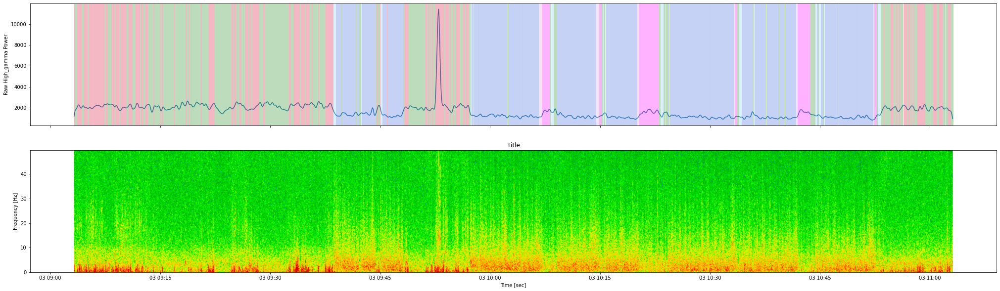

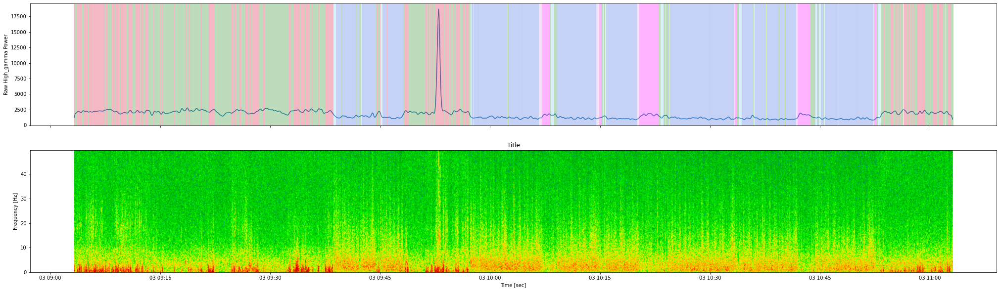

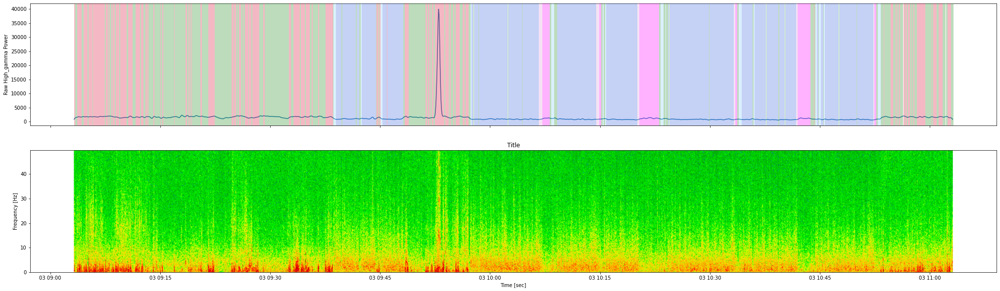

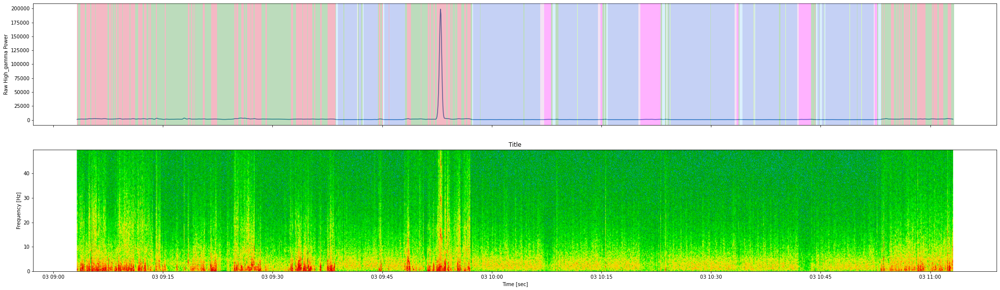

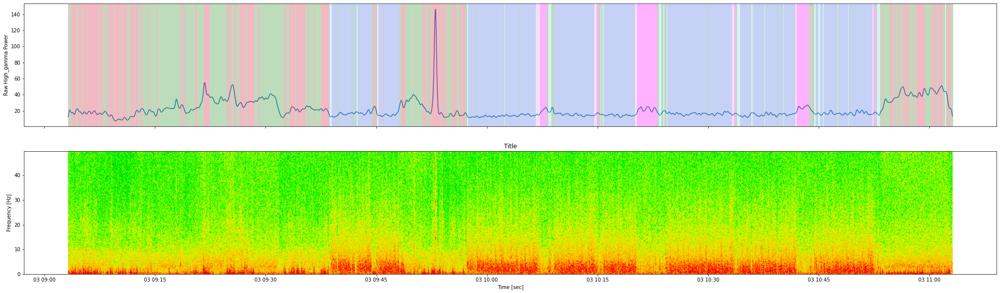

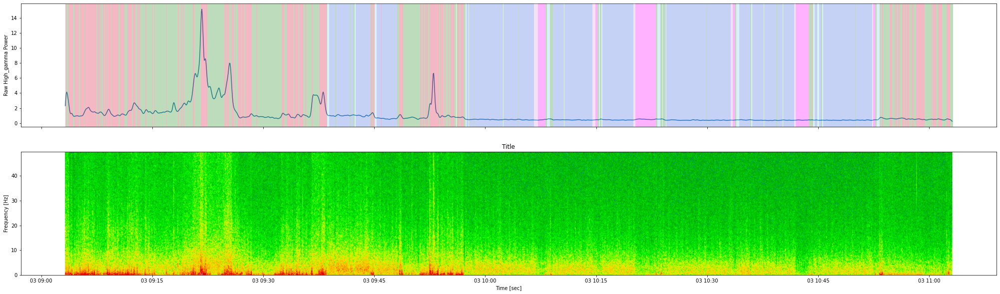

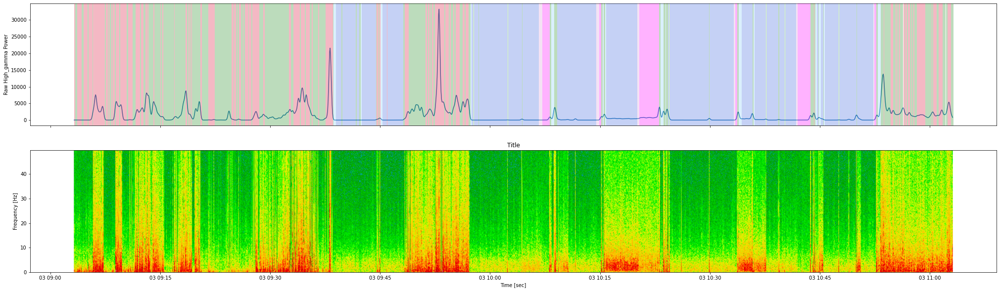

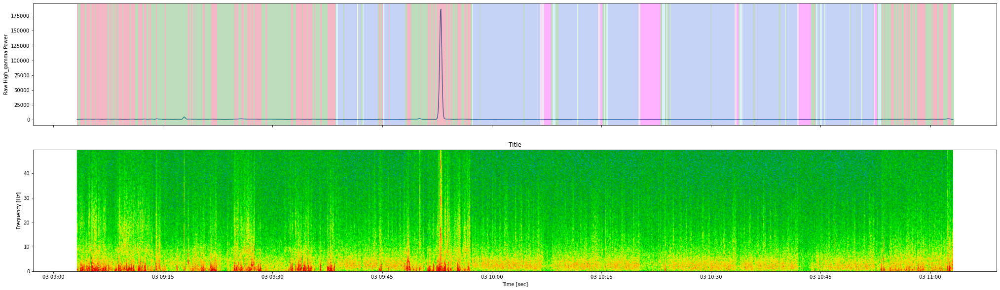

In [10]:
for chan in [1,3,5,7,9,11,13,15]:
    b, s = kp.plot_bp_and_spectro(art['fspg'], chan=chan, hyp=art['hyp_2hr'], bp_def=bp_def, band='high_gamma')

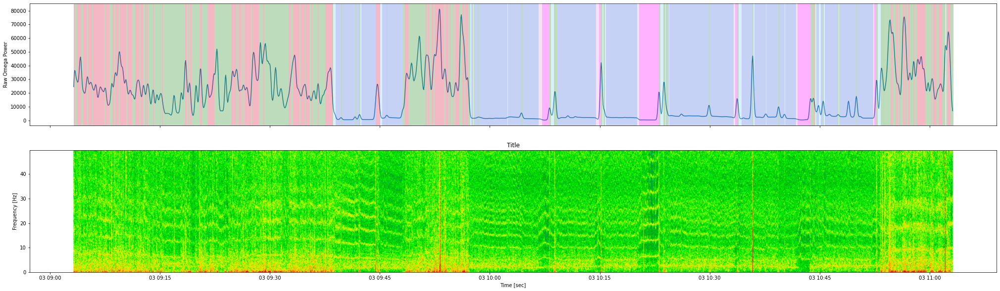

In [11]:
for chan in [1]:
    b, s = kp.plot_bp_and_spectro(art['mspg'], chan=chan, hyp=art['hyp_2hr'], bp_def=bp_def, band='omega')

In [7]:
omg = kd.get_bandpower(art['mspg'], f_range=bp_def['omega'])

In [8]:
omgs = kd.get_smoothed_da(omg, smoothing_sigma=12)

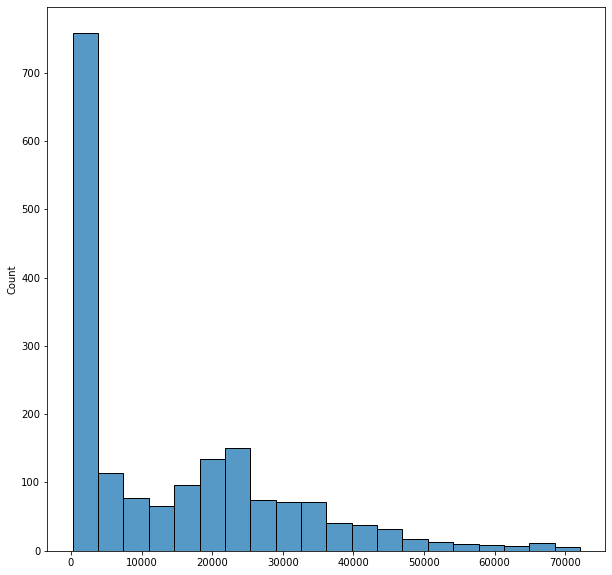

In [9]:
ax = kp.quick_histo(omgs.sel(channel=1).values)